In [1]:
import pandas as pd
import plotly.express as px
import glob
import os

In [2]:
# Define a function to convert seconds to years, days, hours, and seconds
def convert_seconds_to_time(seconds):
    years = seconds / (365.25 * 24 * 3600)
    days = (seconds / (24 * 3600))
    hours = seconds / 3600
    seconds = seconds
    return years, days, hours, seconds

In [4]:
df = pd.read_csv("./resources/bp1-qd/erickson/erickson_bp1-qd_fltst_dp000.dat", comment='#', delim_whitespace=True)
df['years'], df['days'], df['hours'], df['seconds'] = convert_seconds_to_time(df['t'])
df

,t,slip,slip_rate,shear_stress,state,years,days,hours,seconds
0,0.000000e+00,0.000000e+00,-9.000000,26.546122,0.591409,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1,1.000000e-03,9.999999e-13,-9.000000,26.546122,3.903090,3.168809e-11,1.157407e-08,2.777778e-07,1.000000e-03
2,1.099213e+04,5.618357e-06,-9.562926,26.546126,4.278376,3.483197e-04,1.272238e-01,3.053370e+00,1.099213e+04
3,4.113129e+06,1.530747e-05,-13.065780,26.548487,6.614980,1.303372e-01,4.760566e+01,1.142536e+03,4.113129e+06
4,2.437484e+07,1.572737e-05,-14.214194,26.559678,7.387069,7.723920e-01,2.821162e+02,6.770788e+03,2.437484e+07
...,...,...,...,...,...,...,...,...,...
43938,9.466306e+10,8.945083e+01,-15.166594,28.542657,9.170264,2.999691e+03,1.095637e+06,2.629529e+07,9.466306e+10
43939,9.466306e+10,8.945083e+01,-15.166594,28.542657,9.170264,2.999691e+03,1.095637e+06,2.629529e+07,9.466306e+10
43940,9.466307e+10,8.945083e+01,-15.166594,28.542663,9.170268,2.999692e+03,1.095637e+06,2.629530e+07,9.466307e+10
43941,9.466954e+10,8.945083e+01,-15.166752,28.545752,9.172162,2.999897e+03,1.095712e+06,2.629709e+07,9.466954e+10


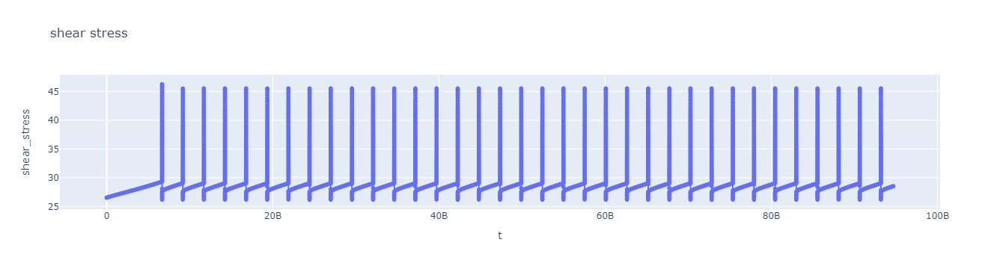

In [5]:
shear_stress_fig = px.line(df, x='t', y='shear_stress', title='shear stress', markers=True)
shear_stress_fig

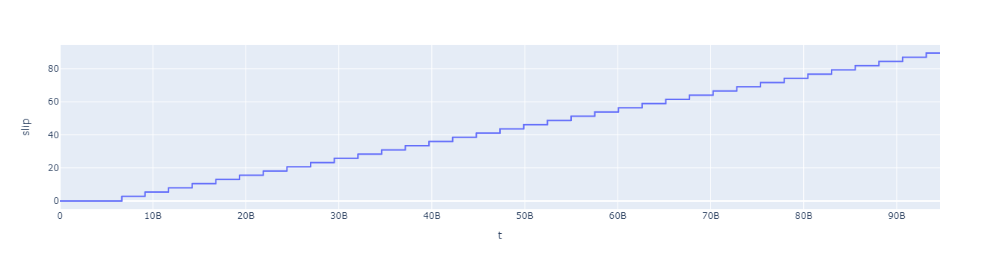

In [6]:
slip_fig = px.line(df, x='t', y='slip')
slip_fig

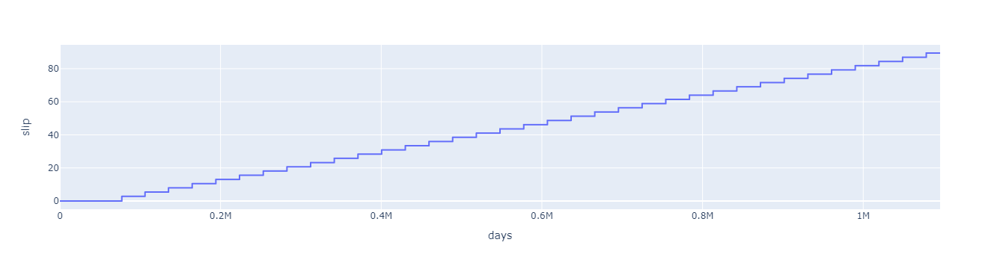

In [7]:
slip_fig = px.line(df, x='days', y='slip')
slip_fig

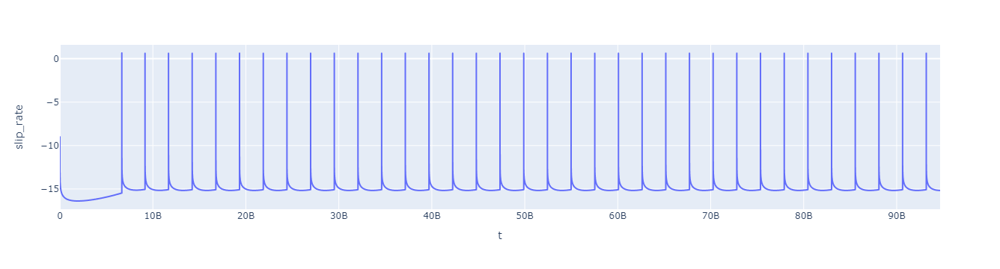

In [8]:
slip_rate_fig = px.line(df, x='t', y='slip_rate')
slip_rate_fig

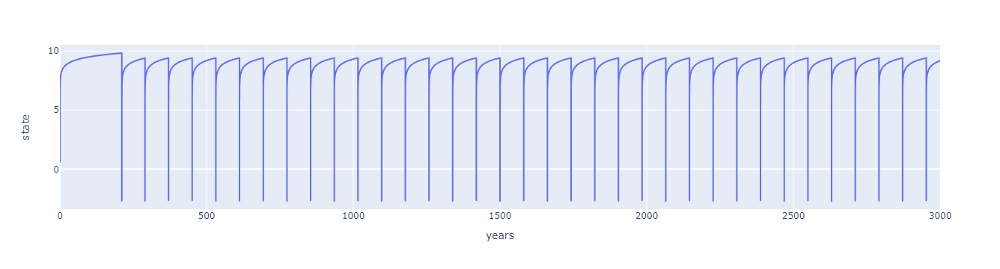

In [9]:
state_fig = px.line(df, x='years', y='state')
state_fig

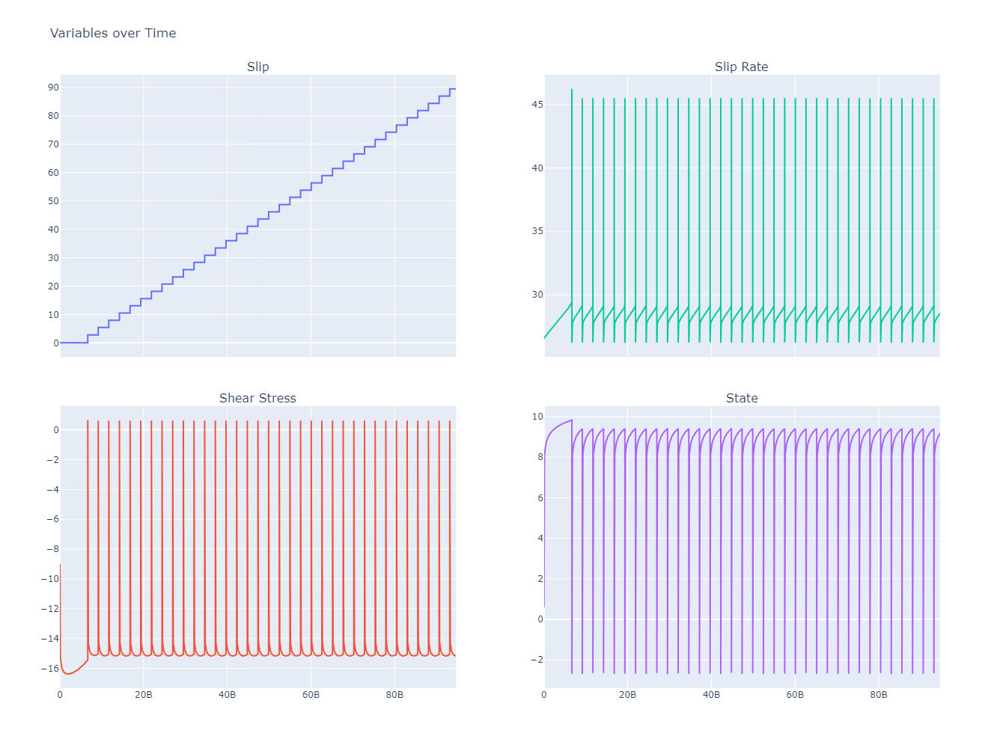

In [10]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
# Assuming df is the DataFrame containing your data
fig = make_subplots(rows=2, cols=2, shared_xaxes=True,
                    subplot_titles=['Slip', 'Slip Rate', 'Shear Stress', 'State'],
                   vertical_spacing=0.08, horizontal_spacing=0.1)

# Add traces for each variable
fig.add_trace(go.Scatter(x=df['t'], y=df['slip'], mode='lines', name='Slip'), row=1, col=1)
fig.add_trace(go.Scatter(x=df['t'], y=df['slip_rate'], mode='lines', name='Slip Rate'), row=2, col=1)
fig.add_trace(go.Scatter(x=df['t'], y=df['shear_stress'], mode='lines', name='Shear Stress'), row=1, col=2)
fig.add_trace(go.Scatter(x=df['t'], y=df['state'], mode='lines', name='State'), row=2, col=2)

# Update layout
fig.update_layout(title='Variables over Time', showlegend=False, height=1000)
fig.update_xaxes(matches='x')
# Show the figure
fig.show()